## Размещение

In [1]:
from blocksnet.utils import SERVICE_TYPES
import pandas as pd


In [2]:
from blocksnet import City

city = City.from_pickle('data/model.pickle')
blocks = city.get_blocks_gdf(True)

In [3]:
blocks.explore()

In [3]:
# blocks.explore()

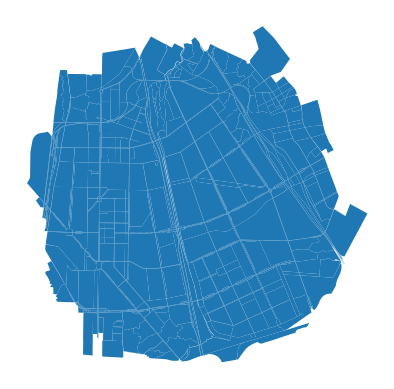

In [5]:
nearest_blocks = blocks.sjoin_nearest(blocks[blocks.index == 5294], distance_col='distance')
nearest_blocks = nearest_blocks[nearest_blocks['distance']<=4000]
nearest_blocks = nearest_blocks.rename(columns=lambda col: col.replace('_left', '') if col.endswith('_left') else col)
nearest_blocks = nearest_blocks.drop(columns=[col for col in nearest_blocks.columns if col.endswith('_right')])
nearest_blocks.plot().set_axis_off()
city._blocks = {i:city[i] for i in nearest_blocks.index}
blocks = city.get_blocks_gdf(True)

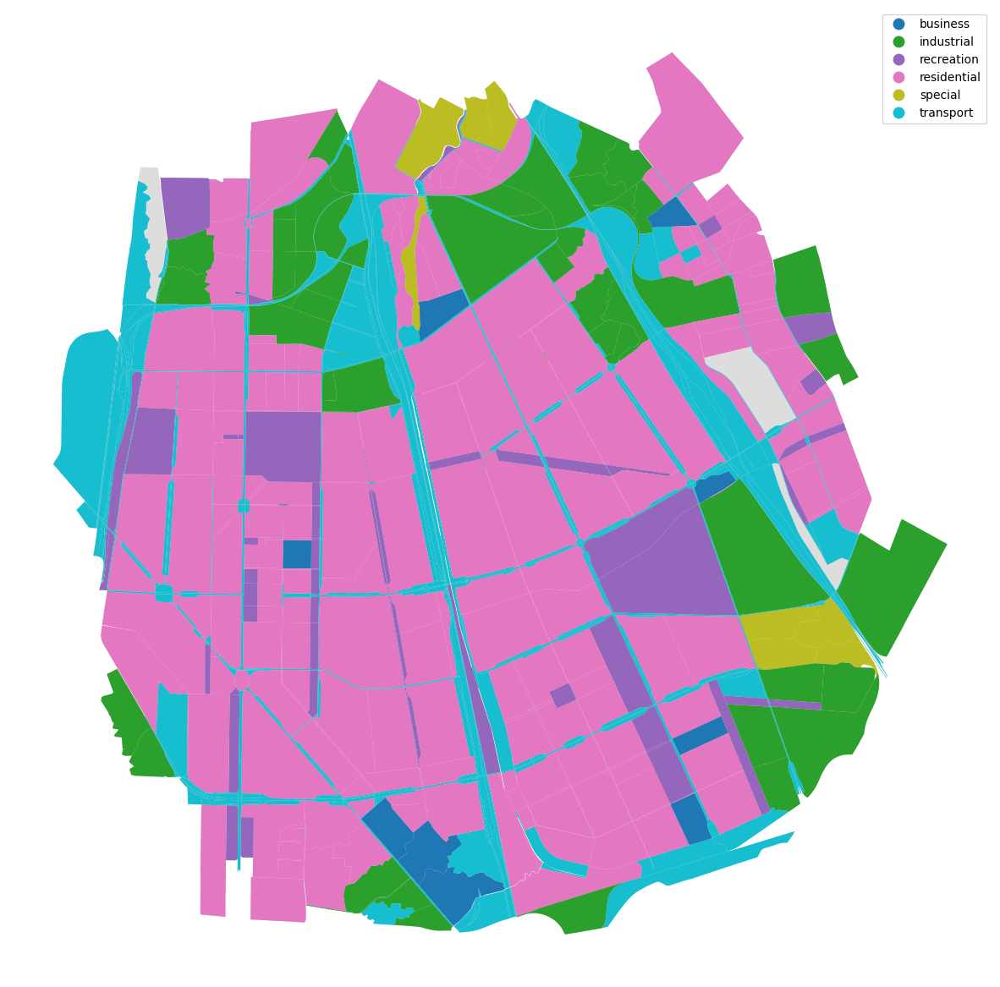

In [6]:
ax = blocks.plot(color='#ddd', figsize=(15,15), linewidth=0)
blocks.plot(column='land_use', legend=True, ax=ax, linewidth=0).set_axis_off()

In [7]:
service_type = 'school'

2024-12-03 14:16:36.900 | INFO     | blocksnet.method.provision:_lp_provision:320 - Setting an LP problem for accessibility = 15 : 185x70
2024-12-03 14:16:36.999 | INFO     | blocksnet.method.provision:_lp_provision:354 - Solving the problem
2024-12-03 14:16:37.774 | INFO     | blocksnet.method.provision:_lp_provision:358 - Restoring values from variables
2024-12-03 14:16:37.818 | SUCCESS  | blocksnet.method.provision:calculate:269 - Provision assessment finished


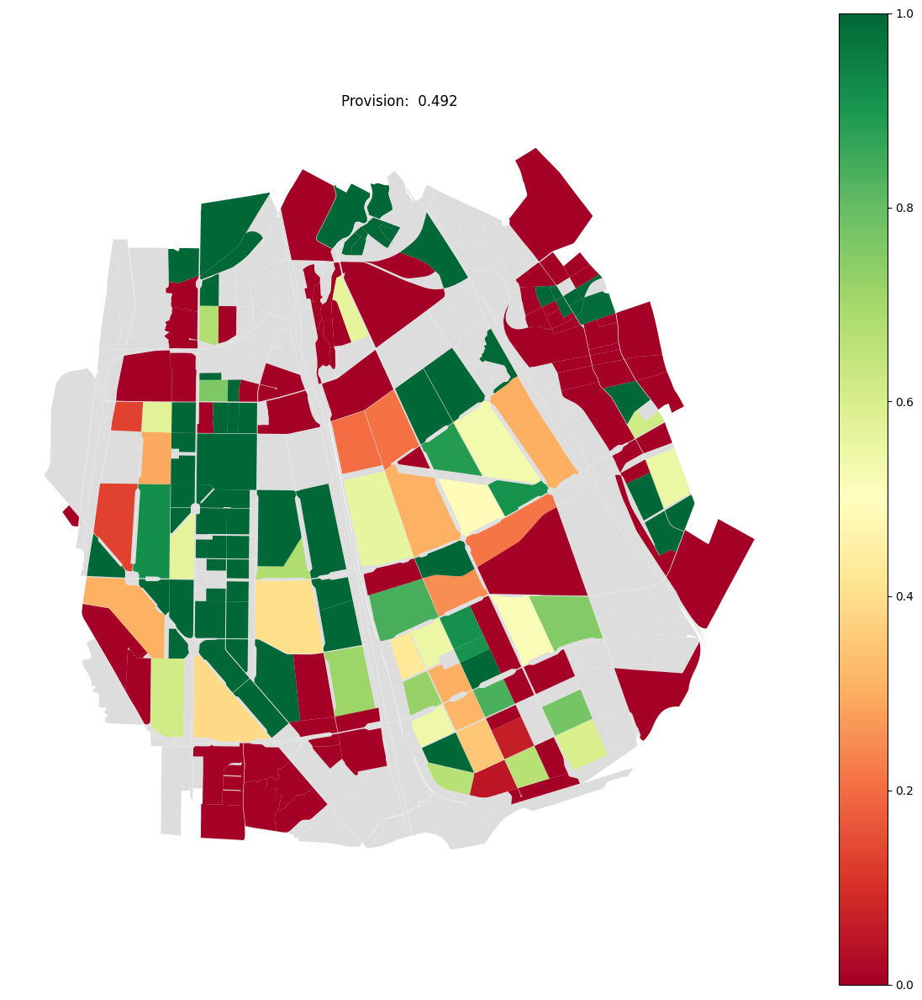

In [8]:
from blocksnet import Provision, ProvisionMethod
provision = Provision(city_model=city)
provision__blocks = provision.calculate(f'{service_type}')
provision.plot(provision__blocks, figsize=(15,15))

In [9]:
provision__blocks = provision__blocks.to_crs(4326)
blocks = blocks.to_crs(4326)
provision__blocks= provision__blocks[provision__blocks['demand']>0]
provision__blocks

,geometry,demand,capacity,capacity_left,demand_left,demand_within,demand_without,provision
id,,,,,,,,
36,"POLYGON ((30.41091 59.88769, 30.41054 59.88776...",75,0.0,0.0,75,0,0,0.0
41,"POLYGON ((30.36677 59.90135, 30.36574 59.90152...",4,0.0,0.0,0,4,0,1.0
72,"POLYGON ((30.35083 59.88685, 30.35068 59.88718...",21,0.0,0.0,21,0,0,0.0
74,"POLYGON ((30.35366 59.88142, 30.35348 59.88146...",19,0.0,0.0,19,0,0,0.0
76,"POLYGON ((30.34798 59.89076, 30.34792 59.89086...",1,0.0,0.0,1,0,0,0.0
...,...,...,...,...,...,...,...,...
7887,"POLYGON ((30.41451 59.89132, 30.41443 59.89141...",75,0.0,0.0,0,75,0,1.0
8279,"POLYGON ((30.33116 59.82421, 30.33116 59.82427...",293,0.0,0.0,293,0,0,0.0
8281,"POLYGON ((30.33113 59.82215, 30.33113 59.82226...",674,0.0,0.0,674,0,0,0.0


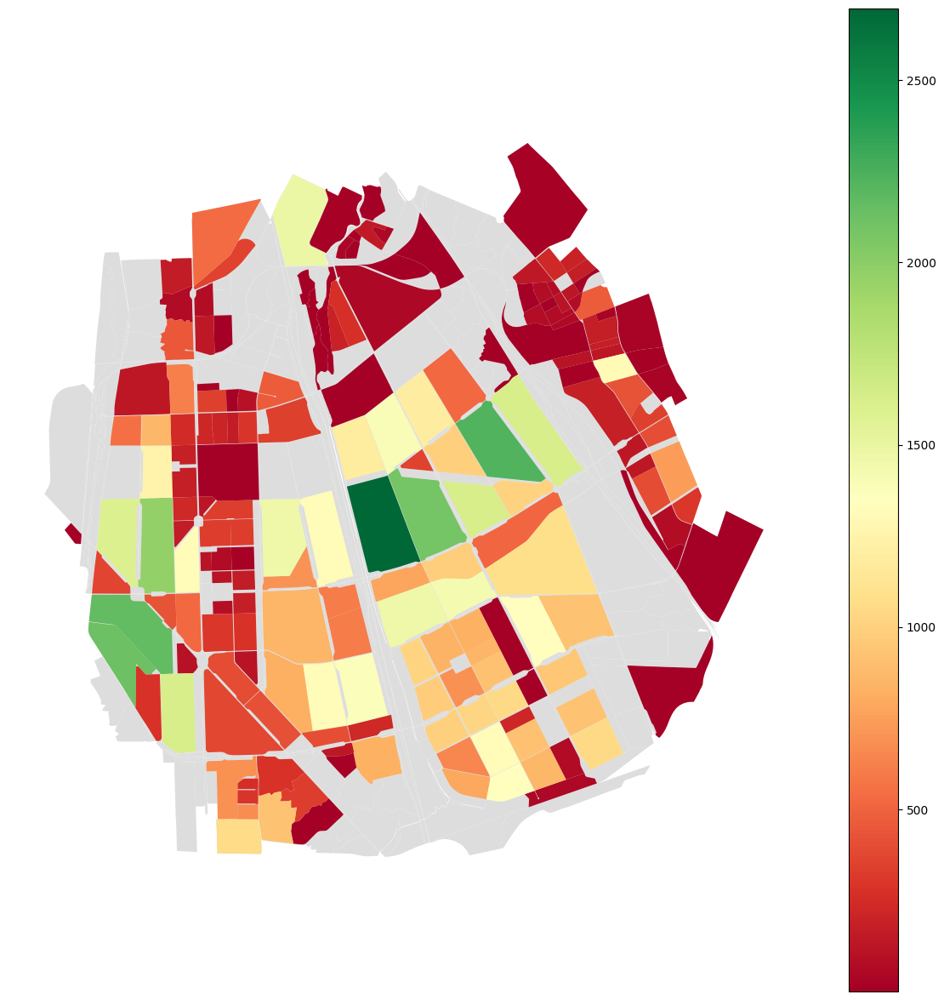

In [10]:
import matplotlib.pyplot as plt
# Визуализация данных по столбцу 'Потенциал територии для размещения сервиса'
fig, ax = plt.subplots(figsize=(15, 15))
blocks.plot(ax=ax, color="#ddd", linewidth=0.1)
provision__blocks.plot(ax=ax, column='demand', linewidth=0.1, legend=True,cmap='RdYlGn')
# ax.set_title(" Средний потенциал: " + f"{service_bloks['Потенциал територии для размещения сервиса'].sum(): .3f}")
# ax.set_title("Количество нуждающихся в сервисе людей")
ax.set_axis_off()

# Отображение графика
plt.show()

In [11]:
import pandas as pd
import geopandas as gpd

service_type = 'school'
# service_type = 'kindergarten'
# service_type = 'polyclinic'
# service_type = 'park'

# Стоимость за одно место для школ
cost_per_capacity_school = {
    250: 1120,
    300: 1129,
    600: 1078,
    1100: 973
}

# Стоимость за одно место для детских садов
cost_per_capacity_kindergarten = {
    80: 1492,
    180: 1234,
    320: 1159
}

# Стоимость за одно место для детских садов
cost_per_capacity_park = {
    270: 1013,
    2100: 735,
    5500: 696,
    5480: 399,
    17800: 224
}

cost_per_capacity_polyclinic = {
    100: 2741,
    150: 2470,
    250: 1929,
    500: 1194
}

# Выбор словаря стоимости в зависимости от типа сервиса
if service_type == 'school':
    cost_per_capacity = cost_per_capacity_school
elif service_type == 'kindergarten':
    cost_per_capacity = cost_per_capacity_kindergarten
elif service_type == 'park':
    cost_per_capacity = cost_per_capacity_park
elif service_type == 'polyclinic':
    cost_per_capacity = cost_per_capacity_polyclinic
else:
    raise ValueError("Неправильный тип сервиса")

city_service = city[f'{service_type}']
city_service.bricks = [brick for brick in city_service.bricks if not brick.is_integrated]
accessibility_matrix = city.accessibility_matrix
blocks = city.get_blocks_gdf(True)

# Шаг 1: Загрузка и объединение данных кварталов
gdf = blocks.merge(provision__blocks, left_index=True, right_index=True, how='inner')
gdf.loc[:, 'geometry'] = gdf['geometry_x']
gdf = gpd.GeoDataFrame(gdf.drop(columns=['geometry_x', 'geometry_y']), geometry='geometry', crs=blocks.crs)

# Шаг 2: Фильтрация жилых кварталов с неудовлетворенным спросом
residential_blocks = gdf.query('demand_left > 0 or demand_without >= 0')

if residential_blocks.empty:
    print("Нет жилых кварталов с неудовлетворенным спросом.")
    pass

# Шаг 3: Фильтрация кварталов по свободной площади для размещения школ или детских садов
service_areas = sorted([brick.area for brick in city_service.bricks], reverse=True)


def filter_blocks_by_area(blocks):
    blocks['free_area'] = blocks['site_area'] - blocks['footprint_area']
    return blocks[blocks.apply(lambda block: any(block['free_area'] >= area for area in service_areas) and block['land_use'] in [lu.value for lu in city_service.land_use], axis=1)]

filtered_blocks = filter_blocks_by_area(gdf)

if filtered_blocks.empty:
    print(f"Нет кварталов, подходящих по площади для размещения {service_type}.")
    pass

# Шаг 4: Оценка стоимости, эффекта, среднего расстояния и общего спроса для каждого квартала

def calculate_block_metrics(idx, block):
    distances = accessibility_matrix.loc[idx, residential_blocks.index] if idx in accessibility_matrix.index else pd.Series()
    accessible_blocks = distances[distances <= city_service.accessibility].index
    total_demand = residential_blocks.loc[accessible_blocks, ['demand_left', 'demand_without']].sum().sum() if len(accessible_blocks) > 0 else 0
    average_distance = distances[accessible_blocks].mean() if len(accessible_blocks) > 0 else 0
    
    best_effect, best_cost, best_area = 0, 0, 0
    for brick in city_service.bricks:
        if total_demand > 0 and block['free_area'] >= brick.area:
            effect = min(total_demand, brick.capacity)
            cost = brick.capacity * cost_per_capacity[brick.capacity]  # Рассчитываем стоимость по количеству мест
            if effect > best_effect:
                best_effect, best_cost, best_area = effect, cost, brick.area
    return best_effect, best_cost, best_area, average_distance, total_demand

# Вычисление метрик для каждого квартала
metrics = [calculate_block_metrics(idx, filtered_blocks.loc[idx]) for idx in filtered_blocks.index]
filtered_blocks[['effect', 'cost', 'area', 'average_distance', 'total_demand']] = pd.DataFrame(metrics, index=filtered_blocks.index)

filtered_blocks = filtered_blocks.query('effect > 0')

def get_capacity_for_area(area):
    return max((brick.capacity for brick in city_service.bricks if area >= brick.area), default=0)

filtered_blocks['capacity'] = filtered_blocks['area'].apply(get_capacity_for_area)

filtered_blocks = filtered_blocks.astype({col: 'float32' for col in filtered_blocks.select_dtypes(include=['float16']).columns})

filtered_blocks = filtered_blocks[filtered_blocks['average_distance'] > 0]
service_bloks = filtered_blocks.copy()
# service_bloks = service_bloks[service_bloks['effect'] == service_bloks['capacity']]
max_total_demand = service_bloks['total_demand'].max()
service_bloks['score'] = (service_bloks['effect'] / service_bloks['capacity']) * \
                         (1 / service_bloks['average_distance']) * \
                         (service_bloks['total_demand'] / max_total_demand) * 1e2
service_bloks['service_type'] = f'{service_type}'
condition = (
    ((service_bloks['service_type'] == 'school') |
     (service_bloks['service_type'] == 'kindergarten') |
     (service_bloks['service_type'] == 'polyclinic')) &
    (service_bloks['free_area'] <= 2 * service_bloks['area'])
)
service_bloks = service_bloks[~condition]

service_bloks = service_bloks[['effect', 'area', 'capacity','average_distance', 'total_demand', 'land_use', 'cost', 'service_type', 'score','geometry']].copy()
service_bloks.columns = ['Количество обеспеченных сервисом людей', 'Площадь сервиса в кв. м', 'Вместимость сервиса чел.', 
                         'Среднее время в мин. до сервиса от жилых кварталов', 'Общий спрос', 'Тип землипользования територии', 
                         'Стоимость постройки сервиса в тыс. рублей', 'Тип сервиса', 'Потенциал територии для размещения сервиса','geometry']
service_bloks = service_bloks.to_crs(epsg=4326)
service_bloks


/Users/mvin/blocksnet/.venv/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/Users/mvin/blocksnet/.venv/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/Users/mvin/blocksnet/.venv/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

,Количество обеспеченных сервисом людей,Площадь сервиса в кв. м,Вместимость сервиса чел.,Среднее время в мин. до сервиса от жилых кварталов,Общий спрос,Тип землипользования територии,Стоимость постройки сервиса в тыс. рублей,Тип сервиса,Потенциал територии для размещения сервиса,geometry
id,,,,,,,,,,
36,954,13000.0,1100,8.898438,954,residential,1070300,school,0.979460,"POLYGON ((30.41091 59.88769, 30.41054 59.88776..."
72,370,8200.0,600,6.855469,370,residential,646800,school,0.350600,"POLYGON ((30.35083 59.88685, 30.35068 59.88718..."
74,370,8200.0,600,9.234375,370,residential,646800,school,0.260280,"POLYGON ((30.35366 59.88142, 30.35348 59.88146..."
76,370,8200.0,600,9.359375,370,residential,646800,school,0.256804,"POLYGON ((30.34798 59.89076, 30.34792 59.89086..."
299,1100,13000.0,1100,11.585938,1594,residential,1070300,school,1.449285,"POLYGON ((30.31469 59.88814, 30.31455 59.88815..."
...,...,...,...,...,...,...,...,...,...,...
7768,1100,13000.0,1100,7.656250,3903,residential,1070300,school,5.370058,"POLYGON ((30.32583 59.81762, 30.32583 59.81773..."
7857,1100,13000.0,1100,11.835938,3004,residential,1070300,school,2.673584,"POLYGON ((30.41578 59.88171, 30.41606 59.88174..."
8279,1100,13000.0,1100,9.765625,4925,residential,1070300,school,5.312546,"POLYGON ((30.33116 59.82421, 30.33116 59.82427..."


In [12]:
service_bloks['Стоимость постройки сервиса в тыс. рублей'].unique()

array([1070300,  646800,  280000])

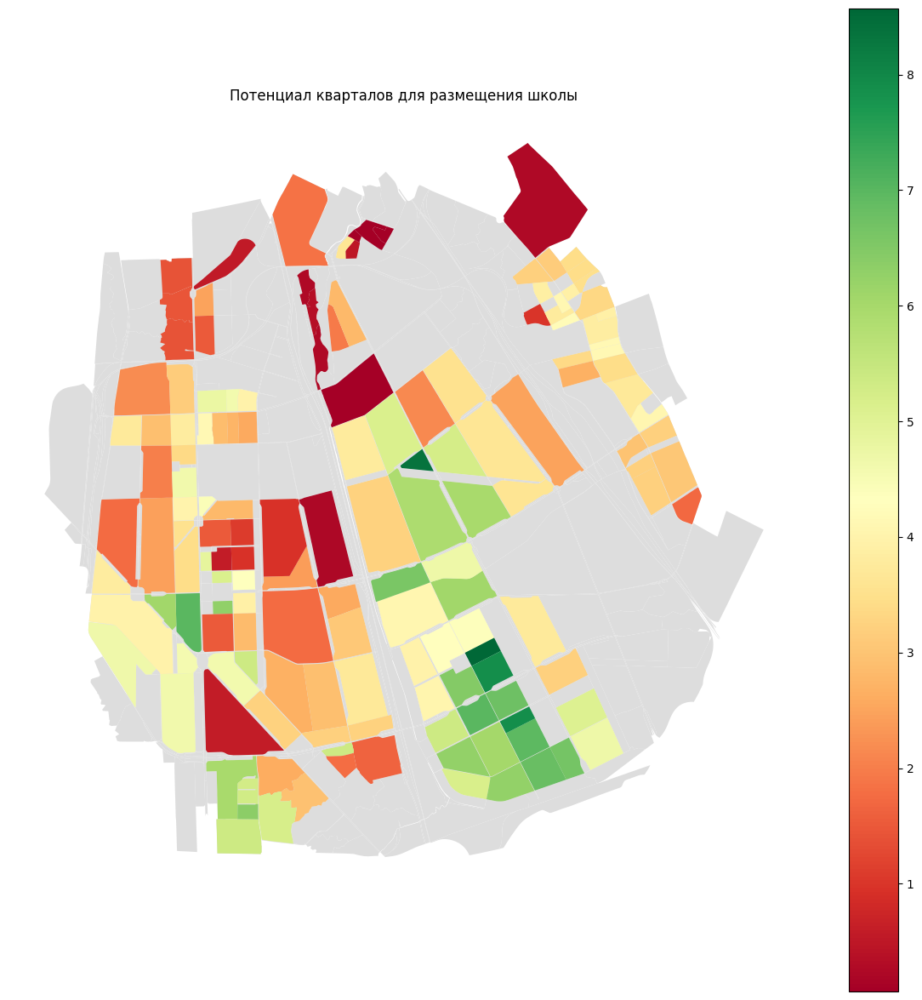

In [14]:
import matplotlib.pyplot as plt
# Визуализация данных по столбцу 'Потенциал територии для размещения сервиса'
blocks = blocks.to_crs(4326)
fig, ax = plt.subplots(figsize=(15, 15))
blocks.plot(ax=ax, color="#ddd", linewidth=0.1)
service_bloks.plot(ax=ax, column='Потенциал територии для размещения сервиса', linewidth=0.1, legend=True,cmap='RdYlGn')
# ax.set_title(" Средний потенциал: " + f"{service_bloks['Потенциал територии для размещения сервиса'].sum(): .3f}")
ax.set_title("Потенциал кварталов для размещения школы")
ax.set_axis_off()

# Отображение графика
plt.show()

In [13]:
# # Тут я делал нужные тебе столбцы, можно автоматизировать по сервистайпу, мне было лень 

# data = gpd.read_file('data/mo_adm_2.geojson')
# mo_data = data[data['municipality_name'].notna()]

# gdf_joined = gpd.sjoin(service_bloks, mo_data, how="left", op='intersects')

# gdf_joined['Сервис расположен в районе'] = gdf_joined['district_name']
# gdf_joined['Сервис расположен в муниципалитете'] = gdf_joined['municipality_name']
# # gdf_joined = gdf_joined.rename(columns={'id_left': 'id'})
# gdf_joined = gdf_joined.drop(columns=['index_right', 'id', 'municipality_name', 'population', 'admin_unit_parent_id', 'district_name', 'name'])
# cols = [col for col in gdf_joined.columns if col != 'geometry'] + ['geometry']
# gdf_joined = gdf_joined[cols]
# # gdf_joined['Тип сервиса'] = gdf_joined['Тип сервиса'].replace('kindergarten', 'Детский сад')
# gdf_joined['Тип сервиса'] = gdf_joined['Тип сервиса'].replace('school', 'Школа')
# # gdf_joined['Тип сервиса'] = gdf_joined['Тип сервиса'].replace('park', 'Парк')
# # gdf_joined['Тип сервиса'] = gdf_joined['Тип сервиса'].replace('polyclinic', 'Поликлиника')
# # gdf_joined['Тип землипользования територии'] = gdf_joined['Тип землипользования територии'].replace({
# #     'residential': 'Жилая зона',
# #     'industrial': 'Производственная зона',
# #     'business': 'Общественно-деловая зона',
# #     'special': 'Зона специального назначения',
# # })
# # gdf_joined['Тип землипользования територии'] = gdf_joined['Тип землипользования територии'].replace({
# #     'recreation': 'Зона рекреационного назначения'
# # })
# gdf_joined['Тип землипользования територии'] = gdf_joined['Тип землипользования територии'].replace({
#     'residential': 'Жилая зона',
#     'business': 'Общественно-деловая зона'
# })
# gdf_joined

In [14]:
# gdf_joined.to_pickle("park.pkl")

In [15]:
# Тут уже функция когда мы задаем денег 
max_budget = 3300000  

# Функция для выбора кварталов
def select_top_blocks_with_score(filtered_blocks, max_budget):
    sorted_blocks = filtered_blocks.sort_values(by=['Потенциал територии для размещения сервиса'], ascending=False)

    selected_blocks = []
    total_cost = 0

    for index, row in sorted_blocks.iterrows():
        if total_cost + row['Стоимость постройки сервиса в тыс. рублей'] <= max_budget:
            selected_blocks.append(row)
            total_cost += row['Стоимость постройки сервиса в тыс. рублей']
        else:
            continue

    result = gpd.GeoDataFrame(selected_blocks, geometry='geometry')
    result = result.set_crs(4326)
    return result

selected_blocks = select_top_blocks_with_score(service_bloks, max_budget)
selected_blocks


,Количество обеспеченных сервисом людей,Площадь сервиса в кв. м,Вместимость сервиса чел.,Среднее время в мин. до сервиса от жилых кварталов,Общий спрос,Тип землипользования територии,Стоимость постройки сервиса в тыс. рублей,Тип сервиса,Потенциал територии для размещения сервиса,geometry
5279,1100,13000.0,1100,11.648438,9478,residential,1070300,school,8.571277,"POLYGON ((30.39887 59.84615, 30.39901 59.84601..."
1242,1100,13000.0,1100,11.992188,9493,residential,1070300,school,8.338762,"POLYGON ((30.37432 59.86872, 30.37424 59.86879..."
3447,1100,13000.0,1100,11.148438,8342,residential,1070300,school,7.882295,"POLYGON ((30.40929 59.83538, 30.40794 59.83504..."


In [16]:
# selected_blocks.to_file('selected_blocks.geojson')

/var/folders/h8/0wmx2zx90bn60jw8zc1r4qjc0000gn/T/ipykernel_11402/881435107.py:5: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  selected_blocks.plot(ax=ax, column='Потенциал територии для размещения сервиса', linewidth=0.1, legend=True,color='green')


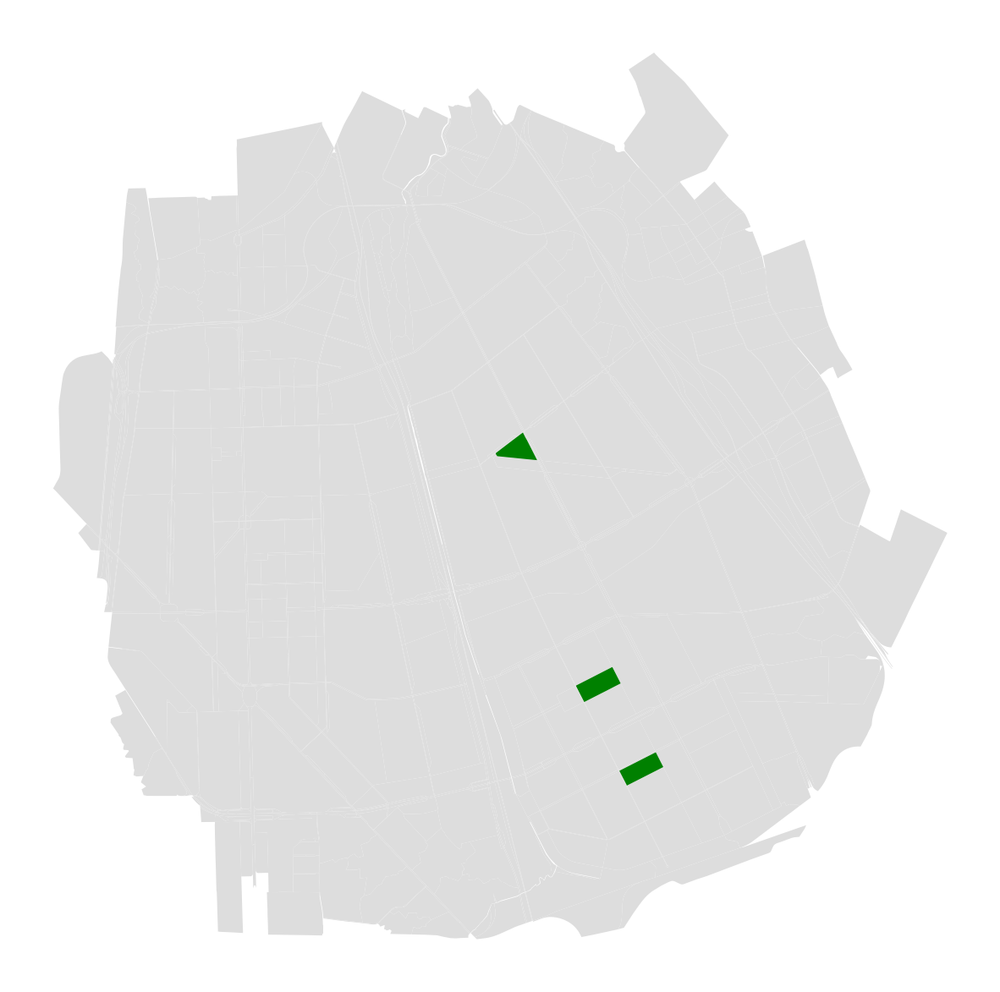

In [24]:
import matplotlib.pyplot as plt
# Визуализация данных по столбцу 'Потенциал територии для размещения сервиса'
fig, ax = plt.subplots(figsize=(15, 15))
blocks.plot(ax=ax, color="#ddd", linewidth=0.1)
selected_blocks.plot(ax=ax, column='Потенциал територии для размещения сервиса', linewidth=0.1, legend=True,color='green')
ax.set_title("")
ax.set_axis_off()

# Отображение графика
plt.show()

In [18]:
selected_blocks['Стоимость постройки сервиса в тыс. рублей'].sum()

3210900

In [19]:
selected_blocks = selected_blocks.rename(columns={'Вместимость сервиса чел.': f'{service_type}'})
selected_blocks

,Количество обеспеченных сервисом людей,Площадь сервиса в кв. м,school,Среднее время в мин. до сервиса от жилых кварталов,Общий спрос,Тип землипользования територии,Стоимость постройки сервиса в тыс. рублей,Тип сервиса,Потенциал територии для размещения сервиса,geometry
5279,1100,13000.0,1100,11.648438,9478,residential,1070300,school,8.571277,"POLYGON ((30.39887 59.84615, 30.39901 59.84601..."
1242,1100,13000.0,1100,11.992188,9493,residential,1070300,school,8.338762,"POLYGON ((30.37432 59.86872, 30.37424 59.86879..."
3447,1100,13000.0,1100,11.148438,8342,residential,1070300,school,7.882295,"POLYGON ((30.40929 59.83538, 30.40794 59.83504..."


2024-10-10 17:52:27.028 | INFO     | blocksnet.method.provision:_lp_provision:320 - Setting an LP problem for accessibility = 15 : 185x72
2024-10-10 17:52:27.129 | INFO     | blocksnet.method.provision:_lp_provision:354 - Solving the problem
2024-10-10 17:52:27.185 | INFO     | blocksnet.method.provision:_lp_provision:358 - Restoring values from variables
2024-10-10 17:52:27.232 | SUCCESS  | blocksnet.method.provision:calculate:269 - Provision assessment finished


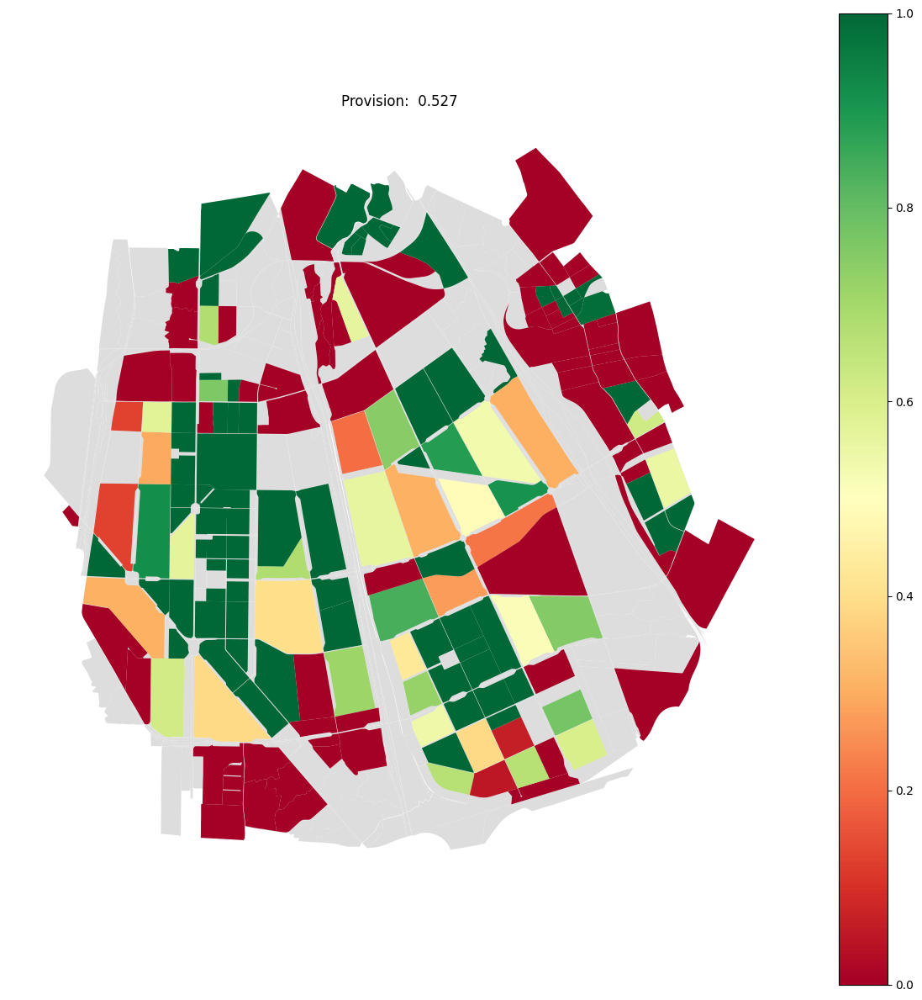

In [20]:
prov_ann = provision.calculate(f'{service_type}', selected_blocks)
provision.plot(prov_ann, figsize=(15,15))

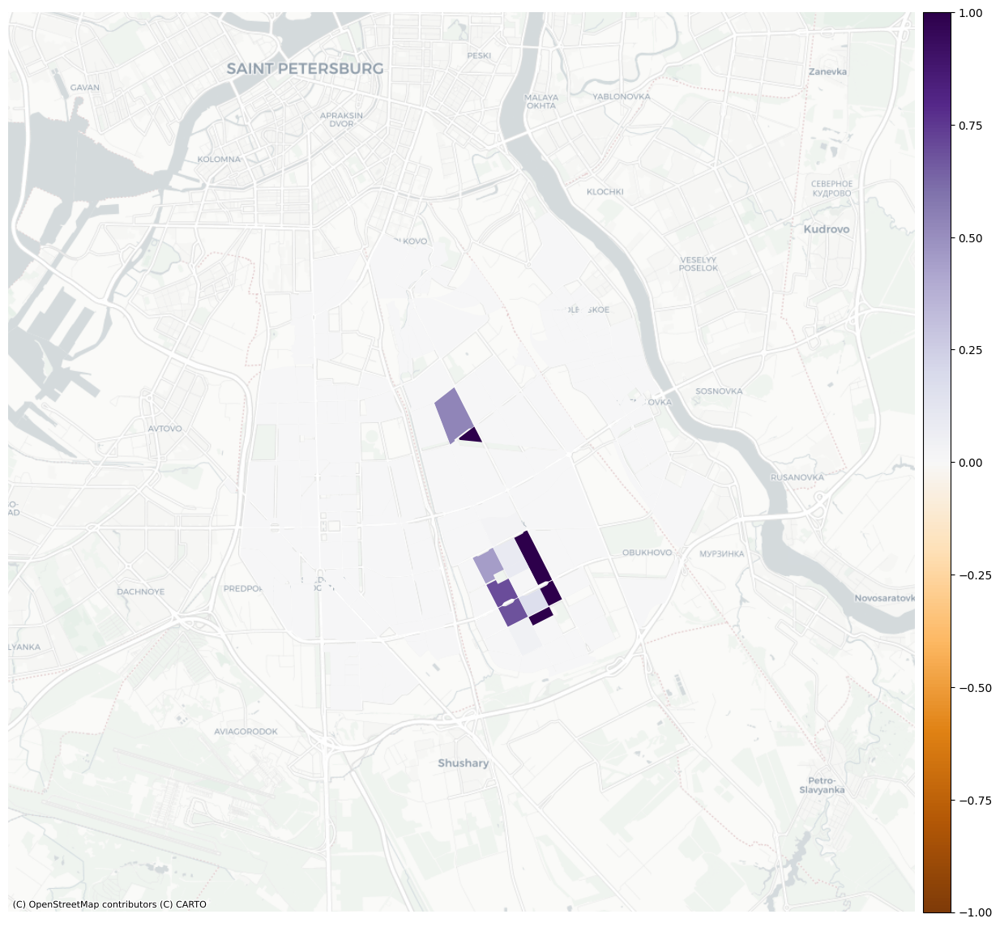

In [30]:
import matplotlib.pyplot as plt
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Преобразование GeoDataFrame в систему координат EPSG:3857
delta_result = prov_ann.copy()
delta_result['provision'] -= provision__blocks['provision']
service_bloks = delta_result.to_crs(epsg=3857)

# Визуализация данных по столбцу 'Потенциал територии для размещения сервиса'
fig, ax = plt.subplots(figsize=(15, 15))
# Визуализация с потенциалом для размещения сервиса
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3%", pad=0.1)  # Настройка размера и отступа для шкалы
# Визуализация кварталов
service_bloks_plot = service_bloks.plot(ax=ax,
  column='provision', 
  vmin=-1, 
  vmax=1, 
  legend=True, 
  linewidth=0.1, 
  figsize=(15,15),
  cmap="PuOr", cax=cax)

# Получение текущих границ и масштабирование
minx, miny, maxx, maxy = service_bloks.total_bounds
buffer_scale = 0.4  # Процент увеличения области
ax.set_xlim(minx - (maxx - minx) * buffer_scale, maxx + (maxx - minx) * buffer_scale)
ax.set_ylim(miny - (maxy - miny) * buffer_scale, maxy + (maxy - miny) * buffer_scale)

# Добавляем подложку Positron с указанием уровня увеличения (zoom)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, zoom=12)
total = service_bloks["demand_within"].sum() / service_bloks["demand"].sum()
# Заголовок и настройки осей
# ax.set_title("Provision: " + f"{total: .3f}")
ax.set_axis_off()

# Отображение граф
plt.show()

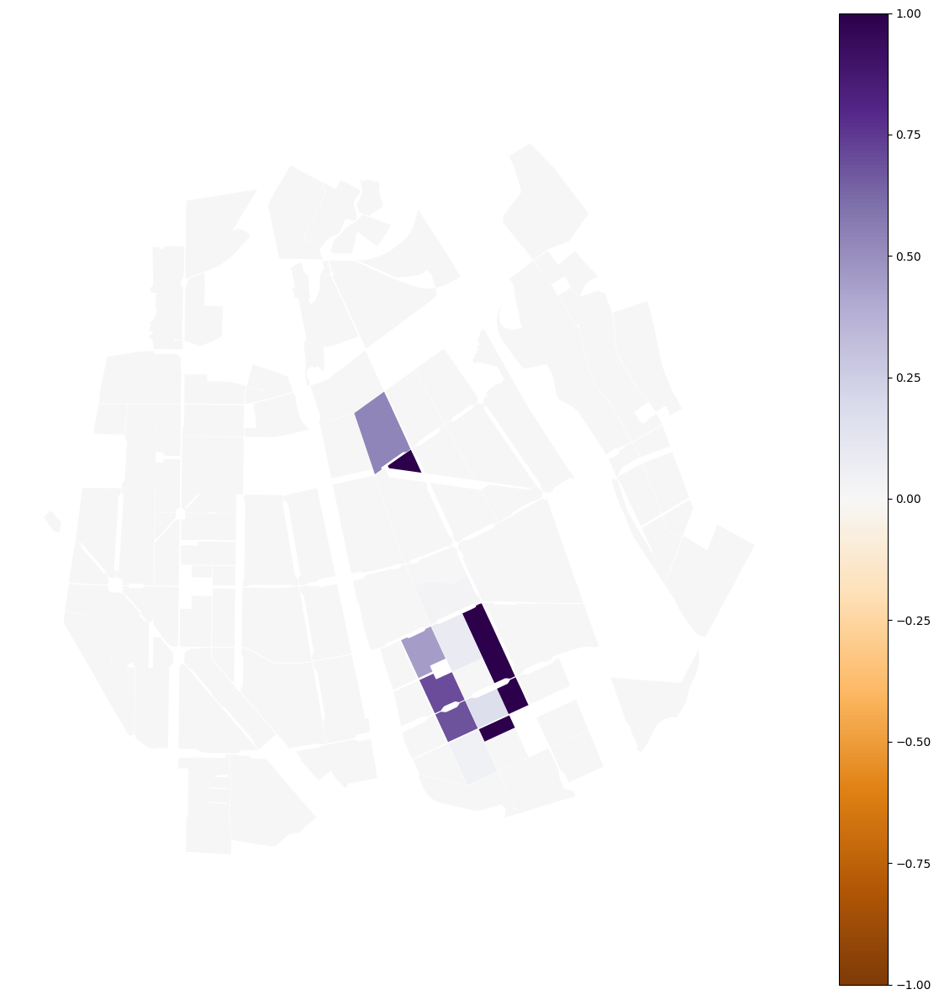

In [21]:
delta_result = prov_ann.copy()
delta_result['provision'] -= provision__blocks['provision']
delta_result.plot(
  column='provision', 
  vmin=-1, 
  vmax=1, 
  legend=True, 
  linewidth=0.1, 
  figsize=(15,15),
  cmap="PuOr"
).set_axis_off()